In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

train_df = pd.read_csv("C:/Users/pfali/Downloads/store-sales-time-series-forecasting/train.csv")
test_df = pd.read_csv("C:/Users/pfali/Downloads/store-sales-time-series-forecasting/test.csv")

stores_df = pd.read_csv("C:/Users/pfali/Downloads/store-sales-time-series-forecasting/stores.csv")
holidays_df = pd.read_csv("C:/Users/pfali/Downloads/store-sales-time-series-forecasting/holidays_events.csv")
transactions_df = pd.read_csv("C:/Users/pfali/Downloads/store-sales-time-series-forecasting/transactions.csv")
oil_df = pd.read_csv("C:/Users/pfali/Downloads/store-sales-time-series-forecasting/oil.csv")

In [2]:
train_df.head()

,id,date,store_nbr,family,sales,onpromotion
0,0,2013-01-01,1,AUTOMOTIVE,0.0,0
1,1,2013-01-01,1,BABY CARE,0.0,0
2,2,2013-01-01,1,BEAUTY,0.0,0
3,3,2013-01-01,1,BEVERAGES,0.0,0
4,4,2013-01-01,1,BOOKS,0.0,0


In [3]:
test_df.head()

,id,date,store_nbr,family,onpromotion
0,3000888,2017-08-16,1,AUTOMOTIVE,0
1,3000889,2017-08-16,1,BABY CARE,0
2,3000890,2017-08-16,1,BEAUTY,2
3,3000891,2017-08-16,1,BEVERAGES,20
4,3000892,2017-08-16,1,BOOKS,0


In [4]:
train_df.isnull().sum()

id             0
date           0
store_nbr      0
family         0
sales          0
onpromotion    0
dtype: int64

In [5]:
test_df.isnull().sum()

id             0
date           0
store_nbr      0
family         0
onpromotion    0
dtype: int64

In [6]:
train_df.dtypes

id               int64
date            object
store_nbr        int64
family          object
sales          float64
onpromotion      int64
dtype: object

In [7]:
test_df.dtypes

id              int64
date           object
store_nbr       int64
family         object
onpromotion     int64
dtype: object

In [8]:
train_df.describe(include='all')

,id,date,store_nbr,family,sales,onpromotion
count,3.000888e+06,3000888,3.000888e+06,3000888,3.000888e+06,3.000888e+06
unique,NaN,1684,NaN,33,NaN,NaN
top,NaN,2013-01-01,NaN,AUTOMOTIVE,NaN,NaN
freq,NaN,1782,NaN,90936,NaN,NaN
mean,1.500444e+06,NaN,2.750000e+01,NaN,3.577757e+02,2.602770e+00
std,8.662819e+05,NaN,1.558579e+01,NaN,1.101998e+03,1.221888e+01
min,0.000000e+00,NaN,1.000000e+00,NaN,0.000000e+00,0.000000e+00
25%,7.502218e+05,NaN,1.400000e+01,NaN,0.000000e+00,0.000000e+00
50%,1.500444e+06,NaN,2.750000e+01,NaN,1.100000e+01,0.000000e+00
75%,2.250665e+06,NaN,4.100000e+01,NaN,1.958473e+02,0.000000e+00


In [9]:
holidays_df.dtypes

date           object
type           object
locale         object
locale_name    object
description    object
transferred      bool
dtype: object

Our target is 'sales'. Some important data are included in different files, which we need to incorporate:
- stores - giving more details on each store
- transactions - specifying the number of transactions in a store at a given date
- holidays_events - specifying holidays, transferred holidays, bridges
- oil - specifying prices of oil during years 2013-2017

We will convert the 'date' to datetime type and family to a categorical, numerical feature.

In [10]:
holidays_df['date']=pd.to_datetime(holidays_df['date'])
transactions_df['date']=pd.to_datetime(transactions_df['date'])
train_df['date']=pd.to_datetime(train_df['date'])
test_df['date']=pd.to_datetime(test_df['date'])
oil_df['date']=pd.to_datetime(oil_df['date'])

In [11]:
holidays_df.rename(columns={"locale_name":"city"},inplace=True)
train_df_=pd.merge(train_df,stores_df,on=['store_nbr'],how='left')
train_df2=pd.merge(train_df_,holidays_df,on=['date','city'],how='left')
train_df3=pd.merge(train_df2,transactions_df,on=['date','store_nbr'],how='left')
train_df3.head()

,id,date,store_nbr,family,sales,onpromotion,city,state,type_x,cluster,type_y,locale,description,transferred,transactions
0,0,2013-01-01,1,AUTOMOTIVE,0.0,0,Quito,Pichincha,D,13,NaN,NaN,NaN,NaN,NaN
1,1,2013-01-01,1,BABY CARE,0.0,0,Quito,Pichincha,D,13,NaN,NaN,NaN,NaN,NaN
2,2,2013-01-01,1,BEAUTY,0.0,0,Quito,Pichincha,D,13,NaN,NaN,NaN,NaN,NaN
3,3,2013-01-01,1,BEVERAGES,0.0,0,Quito,Pichincha,D,13,NaN,NaN,NaN,NaN,NaN
4,4,2013-01-01,1,BOOKS,0.0,0,Quito,Pichincha,D,13,NaN,NaN,NaN,NaN,NaN


Most of the tables are merged, we need to do this with the oil_df too. Before that let's impute missing values.

In [12]:
oil_df.isnull().sum()

date           0
dcoilwtico    43
dtype: int64

In [13]:
ind=oil_df.loc[pd.isnull(oil_df['dcoilwtico'])].index
indices=ind.values.tolist()
for item in indices:
    mean_value=oil_df['dcoilwtico'][[item+2,item+1]].mean()
    oil_df['dcoilwtico'].fillna(value=mean_value,inplace=True)

oil_df.head()

,date,dcoilwtico
0,2013-01-01,93.055
1,2013-01-02,93.140
2,2013-01-03,92.970
3,2013-01-04,93.120
4,2013-01-07,93.200


In [14]:
train_df_fin=pd.merge(train_df3,oil_df,on=['date'],how='left')
train_df_fin.head()

,id,date,store_nbr,family,sales,onpromotion,city,state,type_x,cluster,type_y,locale,description,transferred,transactions,dcoilwtico
0,0,2013-01-01,1,AUTOMOTIVE,0.0,0,Quito,Pichincha,D,13,NaN,NaN,NaN,NaN,NaN,93.055
1,1,2013-01-01,1,BABY CARE,0.0,0,Quito,Pichincha,D,13,NaN,NaN,NaN,NaN,NaN,93.055
2,2,2013-01-01,1,BEAUTY,0.0,0,Quito,Pichincha,D,13,NaN,NaN,NaN,NaN,NaN,93.055
3,3,2013-01-01,1,BEVERAGES,0.0,0,Quito,Pichincha,D,13,NaN,NaN,NaN,NaN,NaN,93.055
4,4,2013-01-01,1,BOOKS,0.0,0,Quito,Pichincha,D,13,NaN,NaN,NaN,NaN,NaN,93.055


In [15]:
train_df_fin.isnull().sum()

id                    0
date                  0
store_nbr             0
family                0
sales                 0
onpromotion           0
city                  0
state                 0
type_x                0
cluster               0
type_y          2988645
locale          2988645
description     2988645
transferred     2988645
transactions     245784
dcoilwtico       857406
dtype: int64

More data engineering is needed:
- dropping 'description', 'locale', 'transferred'
- fill nulls in 'transactions' with zeros
- rename 'type_y' to 'isHoliday', replace nulls and values 'Workday' with zeros, replace other values with ones
- create new features 'isWorkday' and 'isWeekend' to determine whether the date belongs to one of these categories
- impute missing values of 'dcoilwtico'

We may consider dropping 'state', as for now, it doesn't seem to carry much information.

In [16]:
train_df_fin.drop(columns=['description','locale','transferred'],inplace=True)
repl=['transactions','type_y']
for x in repl:
    train_df_fin[x].fillna(value=0,inplace=True)

train_df_fin['type_y'].replace({"Work Day":0,"Additional":1,"Holiday":1,"Transfer":1,"Bridge":1,"Event":1},inplace=True)

train_df_fin.rename(columns={"type_y":"isHoliday"},inplace=True)

In [17]:
def check_date(x):
    return bool(len(pd.bdate_range(x,x)))

train_df_fin['isWorkday']=train_df_fin['date'].apply(check_date)
train_df_fin['isWeekend']=train_df_fin['date'].apply(check_date)

In [18]:
train_df_fin.head()

,id,date,store_nbr,family,sales,onpromotion,city,state,type_x,cluster,isHoliday,transactions,dcoilwtico,isWorkday,isWeekend
0,0,2013-01-01,1,AUTOMOTIVE,0.0,0,Quito,Pichincha,D,13,0,0.0,93.055,True,True
1,1,2013-01-01,1,BABY CARE,0.0,0,Quito,Pichincha,D,13,0,0.0,93.055,True,True
2,2,2013-01-01,1,BEAUTY,0.0,0,Quito,Pichincha,D,13,0,0.0,93.055,True,True
3,3,2013-01-01,1,BEVERAGES,0.0,0,Quito,Pichincha,D,13,0,0.0,93.055,True,True
4,4,2013-01-01,1,BOOKS,0.0,0,Quito,Pichincha,D,13,0,0.0,93.055,True,True


In [19]:
plt.figure(figsize=(20,5))
sns.barplot(data=train_df_fin_,x='store_nbr',y='sales',hue='isHoliday',ci=None)
plt.show

NameError: name 'train_df_fin_' is not defined

<Figure size 2000x500 with 0 Axes>

In [20]:
train_df_fin['isWeekend'].replace({True:"not weekend",False:"is weekend"},inplace=True)
train_df_fin.head()

,id,date,store_nbr,family,sales,onpromotion,city,state,type_x,cluster,isHoliday,transactions,dcoilwtico,isWorkday,isWeekend
0,0,2013-01-01,1,AUTOMOTIVE,0.0,0,Quito,Pichincha,D,13,0,0.0,93.055,True,not weekend
1,1,2013-01-01,1,BABY CARE,0.0,0,Quito,Pichincha,D,13,0,0.0,93.055,True,not weekend
2,2,2013-01-01,1,BEAUTY,0.0,0,Quito,Pichincha,D,13,0,0.0,93.055,True,not weekend
3,3,2013-01-01,1,BEVERAGES,0.0,0,Quito,Pichincha,D,13,0,0.0,93.055,True,not weekend
4,4,2013-01-01,1,BOOKS,0.0,0,Quito,Pichincha,D,13,0,0.0,93.055,True,not weekend


In [21]:
train_df_fin['isWeekend'].replace({"not weekend":0,"is weekend":1},inplace=True)
train_df_fin.head()

,id,date,store_nbr,family,sales,onpromotion,city,state,type_x,cluster,isHoliday,transactions,dcoilwtico,isWorkday,isWeekend
0,0,2013-01-01,1,AUTOMOTIVE,0.0,0,Quito,Pichincha,D,13,0,0.0,93.055,True,0
1,1,2013-01-01,1,BABY CARE,0.0,0,Quito,Pichincha,D,13,0,0.0,93.055,True,0
2,2,2013-01-01,1,BEAUTY,0.0,0,Quito,Pichincha,D,13,0,0.0,93.055,True,0
3,3,2013-01-01,1,BEVERAGES,0.0,0,Quito,Pichincha,D,13,0,0.0,93.055,True,0
4,4,2013-01-01,1,BOOKS,0.0,0,Quito,Pichincha,D,13,0,0.0,93.055,True,0


In [22]:
indi=train_df_fin.loc[pd.isnull(train_df_fin['dcoilwtico'])].index
indices2=indi.values.tolist()
for item in indices2:
    mean_val=train_df_fin['dcoilwtico'][[item-1,item+1]].mean()
    train_df_fin['dcoilwtico'].fillna(value=mean_val,inplace=True)

In [23]:
train_df_fin.isnull().sum()

id              0
date            0
store_nbr       0
family          0
sales           0
onpromotion     0
city            0
state           0
type_x          0
cluster         0
isHoliday       0
transactions    0
dcoilwtico      0
isWorkday       0
isWeekend       0
dtype: int64

In [24]:
train_df_fin.head()

,id,date,store_nbr,family,sales,onpromotion,city,state,type_x,cluster,isHoliday,transactions,dcoilwtico,isWorkday,isWeekend
0,0,2013-01-01,1,AUTOMOTIVE,0.0,0,Quito,Pichincha,D,13,0,0.0,93.055,True,0
1,1,2013-01-01,1,BABY CARE,0.0,0,Quito,Pichincha,D,13,0,0.0,93.055,True,0
2,2,2013-01-01,1,BEAUTY,0.0,0,Quito,Pichincha,D,13,0,0.0,93.055,True,0
3,3,2013-01-01,1,BEVERAGES,0.0,0,Quito,Pichincha,D,13,0,0.0,93.055,True,0
4,4,2013-01-01,1,BOOKS,0.0,0,Quito,Pichincha,D,13,0,0.0,93.055,True,0


In [25]:
filter=train_df_fin[train_df_fin['isHoliday']==1].index
train_df_fin.loc[filter,'isWorkday']=False
train_df_fin.loc[filter,'isWeekend']=0
filter2=train_df_fin[train_df_fin['isHoliday']==1]

In [26]:
train_df_fin['isWorkday'].replace({True:1,False:0},inplace=True)

In [27]:
train_df_fin.head()

,id,date,store_nbr,family,sales,onpromotion,city,state,type_x,cluster,isHoliday,transactions,dcoilwtico,isWorkday,isWeekend
0,0,2013-01-01,1,AUTOMOTIVE,0.0,0,Quito,Pichincha,D,13,0,0.0,93.055,1,0
1,1,2013-01-01,1,BABY CARE,0.0,0,Quito,Pichincha,D,13,0,0.0,93.055,1,0
2,2,2013-01-01,1,BEAUTY,0.0,0,Quito,Pichincha,D,13,0,0.0,93.055,1,0
3,3,2013-01-01,1,BEVERAGES,0.0,0,Quito,Pichincha,D,13,0,0.0,93.055,1,0
4,4,2013-01-01,1,BOOKS,0.0,0,Quito,Pichincha,D,13,0,0.0,93.055,1,0


We imputed some missing values for feature 'dcoiltwico', created new features 'isWeekend' and 'isWorkday' and changed these values of them to 0, which were holidays at the same time, so that we don't have overlapping values for these three categories.

In [28]:
train_df_fin_=pd.get_dummies(train_df_fin,columns=['family'])
a=train_df_fin_.columns.tolist()
print(a)
train_df_fin_[['family_AUTOMOTIVE', 'family_BABY CARE', 'family_BEAUTY', 'family_BEVERAGES', 'family_BOOKS', 'family_BREAD/BAKERY', 'family_CELEBRATION', 'family_CLEANING', 'family_DAIRY', 'family_DELI', 'family_EGGS', 'family_FROZEN FOODS', 'family_GROCERY I', 'family_GROCERY II', 'family_HARDWARE', 'family_HOME AND KITCHEN I', 'family_HOME AND KITCHEN II', 'family_HOME APPLIANCES', 'family_HOME CARE', 'family_LADIESWEAR', 'family_LAWN AND GARDEN', 'family_LINGERIE', 'family_LIQUOR,WINE,BEER', 'family_MAGAZINES', 'family_MEATS', 'family_PERSONAL CARE', 'family_PET SUPPLIES', 'family_PLAYERS AND ELECTRONICS', 'family_POULTRY', 'family_PREPARED FOODS', 'family_PRODUCE', 'family_SCHOOL AND OFFICE SUPPLIES', 'family_SEAFOOD']]=train_df_fin_[['family_AUTOMOTIVE', 'family_BABY CARE', 'family_BEAUTY', 'family_BEVERAGES', 'family_BOOKS', 'family_BREAD/BAKERY', 'family_CELEBRATION', 'family_CLEANING', 'family_DAIRY', 'family_DELI', 'family_EGGS', 'family_FROZEN FOODS', 'family_GROCERY I', 'family_GROCERY II', 'family_HARDWARE', 'family_HOME AND KITCHEN I', 'family_HOME AND KITCHEN II', 'family_HOME APPLIANCES', 'family_HOME CARE', 'family_LADIESWEAR', 'family_LAWN AND GARDEN', 'family_LINGERIE', 'family_LIQUOR,WINE,BEER', 'family_MAGAZINES', 'family_MEATS', 'family_PERSONAL CARE', 'family_PET SUPPLIES', 'family_PLAYERS AND ELECTRONICS', 'family_POULTRY', 'family_PREPARED FOODS', 'family_PRODUCE', 'family_SCHOOL AND OFFICE SUPPLIES', 'family_SEAFOOD']].astype(int)

['id', 'date', 'store_nbr', 'sales', 'onpromotion', 'city', 'state', 'type_x', 'cluster', 'isHoliday', 'transactions', 'dcoilwtico', 'isWorkday', 'isWeekend', 'family_AUTOMOTIVE', 'family_BABY CARE', 'family_BEAUTY', 'family_BEVERAGES', 'family_BOOKS', 'family_BREAD/BAKERY', 'family_CELEBRATION', 'family_CLEANING', 'family_DAIRY', 'family_DELI', 'family_EGGS', 'family_FROZEN FOODS', 'family_GROCERY I', 'family_GROCERY II', 'family_HARDWARE', 'family_HOME AND KITCHEN I', 'family_HOME AND KITCHEN II', 'family_HOME APPLIANCES', 'family_HOME CARE', 'family_LADIESWEAR', 'family_LAWN AND GARDEN', 'family_LINGERIE', 'family_LIQUOR,WINE,BEER', 'family_MAGAZINES', 'family_MEATS', 'family_PERSONAL CARE', 'family_PET SUPPLIES', 'family_PLAYERS AND ELECTRONICS', 'family_POULTRY', 'family_PREPARED FOODS', 'family_PRODUCE', 'family_SCHOOL AND OFFICE SUPPLIES', 'family_SEAFOOD']


In [37]:
#pd.set_option('display.max_rows',None)
#train_df_fin_[['sales','date','store_nbr']].groupby([pd.Grouper(key='date',freq='D'),'store_nbr','isHoliday']).sum().round(2).reset_index()

,date,store_nbr,sales
0,2013-01-01,1,0.00
1,2013-01-01,2,0.00
2,2013-01-01,3,0.00
3,2013-01-01,4,0.00
4,2013-01-01,5,0.00
5,2013-01-01,6,0.00
6,2013-01-01,7,0.00
7,2013-01-01,8,0.00
8,2013-01-01,9,0.00
9,2013-01-01,10,0.00


C:\Users\pfali\AppData\Local\Temp\ipykernel_40952\1378758265.py:4: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(data=train_df_fin_,x='store_nbr',y='sales',hue=d,ci=None)
C:\Users\pfali\AppData\Local\Temp\ipykernel_40952\1378758265.py:4: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(data=train_df_fin_,x='store_nbr',y='sales',hue=d,ci=None)
C:\Users\pfali\AppData\Local\Temp\ipykernel_40952\1378758265.py:4: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(data=train_df_fin_,x='store_nbr',y='sales',hue=d,ci=None)


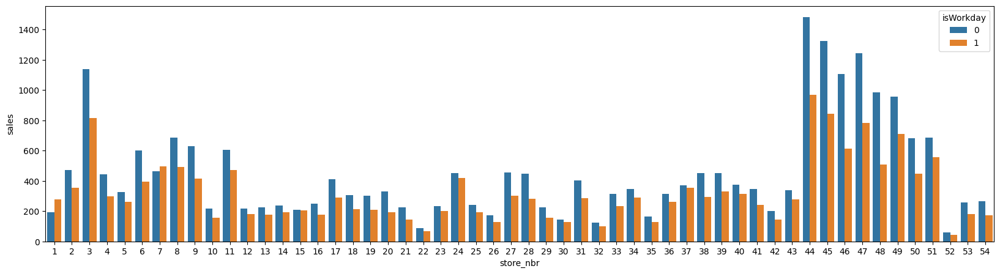

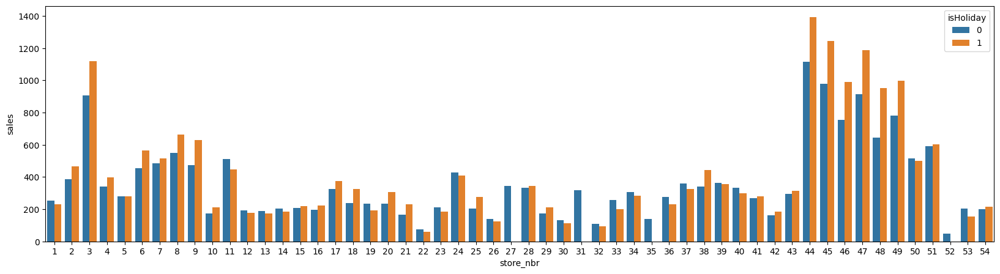

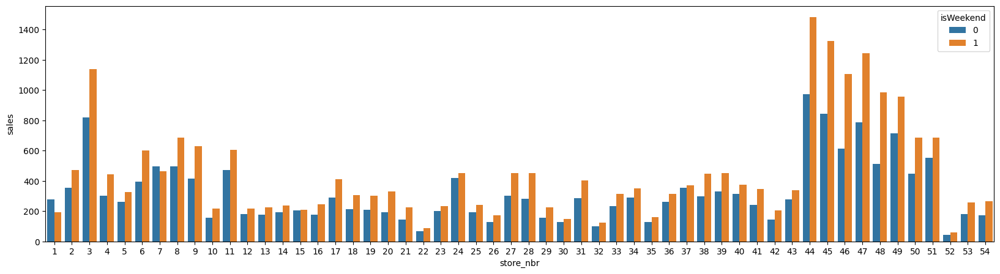

In [30]:
days=['isWorkday','isHoliday','isWeekend']
for d in days:
    plt.figure(figsize=(20,5))
    sns.barplot(data=train_df_fin_,x='store_nbr',y='sales',hue=d,ci=None)
    plt.show


C:\Users\pfali\AppData\Local\Temp\ipykernel_40952\3191374469.py:2: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(data=train_df_fin_,x='store_nbr',y='sales',ci=None)


<function matplotlib.pyplot.show(close=None, block=None)>

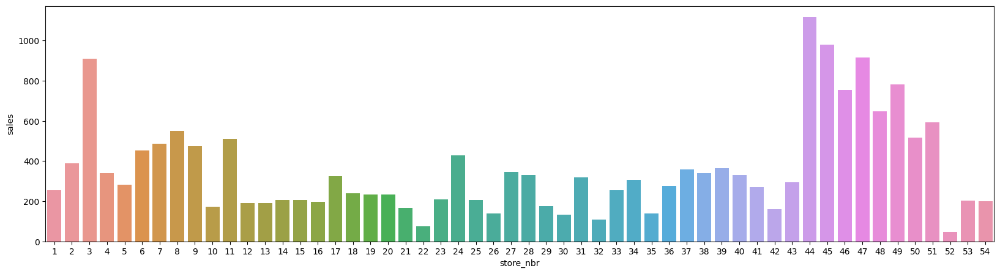

In [38]:
plt.figure(figsize=(20,5))
sns.barplot(data=train_df_fin_,x='store_nbr',y='sales',ci=None)
plt.show

In [31]:
products=pd.unique(train_df_fin['family']).tolist()
for product in products:

SyntaxError: incomplete input (1130979484.py, line 2)